Falls umap nicht installiert ist den code auskommentieren und ausführen

In [1]:
#!pip install umap-learn

In [1]:
import sqlite3
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
import struct
import numpy as np
import umap.umap_ as umap
from sklearn.preprocessing import StandardScaler

c:\Users\khan0\Anaconda3\envs\main\Lib\site-packages\umap\distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
c:\Users\khan0\Anaconda3\envs\main\Lib\site-packages\umap\distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
c:\Users\khan0\Anaconda3\envs\main\Lib\site-packages\umap\distances.py:1086: NumbaDeprecatio

Datenbank und pickel datei öffnen, zusammenführen und verkleinern

In [2]:

path = "C:\\VM\HSD\\big_data\\Big_Data\\Scripts\\databases\\Big_data_database.db"
conn = sqlite3.connect(path)
curs = conn.cursor()
sql_query = "SELECT * FROM Labels"
Labels = pd.read_sql(sql_query, con=conn)
curs.close()
conn.close()

In [27]:

df1 = pd.read_pickle("Data\\Pickle_embeddings_test.pkl")

In [28]:

df1 = df1.reset_index()
df1

,index,0,1,2,3,4,5,6,7,8,...,990,991,992,993,994,995,996,997,998,999
0,E:\images\weather_image_recognition\dew\2208.jpg,0.000347,0.000120,0.000243,0.000676,0.000248,0.000076,0.000101,0.000201,0.000280,...,0.004273,0.000501,0.000176,0.000082,0.000165,0.000647,0.000279,0.000455,0.000074,0.000441
1,E:\images\weather_image_recognition\dew\2209.jpg,0.000064,0.000102,0.000083,0.000029,0.000012,0.000038,0.000023,0.000051,0.000033,...,0.001184,0.001124,0.000293,0.000032,0.013496,0.000356,0.000690,0.000025,0.012776,0.001118
2,E:\images\weather_image_recognition\dew\2210.jpg,0.000143,0.000259,0.000240,0.000082,0.000146,0.000179,0.000085,0.000066,0.000347,...,0.000954,0.026839,0.000591,0.000534,0.003968,0.005793,0.001179,0.000167,0.003011,0.000126
3,E:\images\weather_image_recognition\dew\2211.jpg,0.000288,0.000116,0.000453,0.000123,0.000438,0.000194,0.000237,0.000170,0.000269,...,0.002029,0.003889,0.000241,0.000086,0.004351,0.000599,0.001893,0.000333,0.027975,0.000049
4,E:\images\weather_image_recognition\dew\2212.jpg,0.000303,0.000935,0.000836,0.000695,0.000849,0.000645,0.000226,0.000168,0.000364,...,0.000089,0.004287,0.000251,0.000129,0.000883,0.005909,0.004969,0.000028,0.006389,0.000074
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
140385,E:\images\coco2017_unlabeled\unlabeled2017\000...,0.000258,0.000410,0.000025,0.000112,0.000301,0.000180,0.000139,0.000116,0.000104,...,0.000596,0.000018,0.000118,0.000034,0.000045,0.000038,0.000112,0.000010,0.000015,0.000606
140386,E:\images\coco2017_unlabeled\unlabeled2017\000...,0.000108,0.000283,0.000034,0.000083,0.000354,0.000051,0.000171,0.000221,0.000341,...,0.000123,0.000099,0.000824,0.000541,0.000140,0.000133,0.000384,0.000167,0.000025,0.000776
140387,E:\images\coco2017_unlabeled\unlabeled2017\000...,0.000003,0.000033,0.000008,0.000037,0.000026,0.000012,0.000010,0.000026,0.000018,...,0.000015,0.000014,0.000016,0.000074,0.000013,0.000012,0.000099,0.000024,0.000038,0.000002
140388,E:\images\coco2017_unlabeled\unlabeled2017\000...,0.000661,0.000237,0.000035,0.000023,0.000010,0.000013,0.000015,0.000145,0.000433,...,0.001884,0.000042,0.000194,0.000016,0.000028,0.000023,0.000224,0.002698,0.000221,0.000332


In [35]:
num = 200
for j in range(5):
    l = [i for i in range(j*num,(j*num)+num)]
    df1[f"c{j}"] = df1[l].sum(axis=1)/num

df1 = df1.rename(columns={'index': 'Pfad'})
df1


,Pfad,0,1,2,3,4,5,6,7,8,...,995,996,997,998,999,c0,c1,c2,c3,c4
0,E:\images\weather_image_recognition\dew\2208.jpg,0.000347,0.000120,0.000243,0.000676,0.000248,0.000076,0.000101,0.000201,0.000280,...,0.000647,0.000279,0.000455,0.000074,0.000441,0.001504,0.000668,0.000517,0.000453,0.001858
1,E:\images\weather_image_recognition\dew\2209.jpg,0.000064,0.000102,0.000083,0.000029,0.000012,0.000038,0.000023,0.000051,0.000033,...,0.000356,0.000690,0.000025,0.012776,0.001118,0.001009,0.001029,0.000576,0.000677,0.001709
2,E:\images\weather_image_recognition\dew\2210.jpg,0.000143,0.000259,0.000240,0.000082,0.000146,0.000179,0.000085,0.000066,0.000347,...,0.005793,0.001179,0.000167,0.003011,0.000126,0.001759,0.001305,0.000290,0.000318,0.001328
3,E:\images\weather_image_recognition\dew\2211.jpg,0.000288,0.000116,0.000453,0.000123,0.000438,0.000194,0.000237,0.000170,0.000269,...,0.000599,0.001893,0.000333,0.027975,0.000049,0.000527,0.001156,0.001623,0.000433,0.001261
4,E:\images\weather_image_recognition\dew\2212.jpg,0.000303,0.000935,0.000836,0.000695,0.000849,0.000645,0.000226,0.000168,0.000364,...,0.005909,0.004969,0.000028,0.006389,0.000074,0.001159,0.000567,0.000820,0.001597,0.000857
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
140385,E:\images\coco2017_unlabeled\unlabeled2017\000...,0.000258,0.000410,0.000025,0.000112,0.000301,0.000180,0.000139,0.000116,0.000104,...,0.000038,0.000112,0.000010,0.000015,0.000606,0.000172,0.000188,0.000906,0.001962,0.001772
140386,E:\images\coco2017_unlabeled\unlabeled2017\000...,0.000108,0.000283,0.000034,0.000083,0.000354,0.000051,0.000171,0.000221,0.000341,...,0.000133,0.000384,0.000167,0.000025,0.000776,0.000289,0.000355,0.001902,0.001739,0.000715
140387,E:\images\coco2017_unlabeled\unlabeled2017\000...,0.000003,0.000033,0.000008,0.000037,0.000026,0.000012,0.000010,0.000026,0.000018,...,0.000012,0.000099,0.000024,0.000038,0.000002,0.000043,0.000031,0.000039,0.000093,0.004793
140388,E:\images\coco2017_unlabeled\unlabeled2017\000...,0.000661,0.000237,0.000035,0.000023,0.000010,0.000013,0.000015,0.000145,0.000433,...,0.000023,0.000224,0.002698,0.000221,0.000332,0.000200,0.000164,0.001490,0.000600,0.002546


In [36]:

max_data = pd.merge(df1, Labels, on='Pfad', how='inner')
max_data

,Pfad,0,1,2,3,4,5,6,7,8,...,Label1,Label1_Wert,Label2,Label2_Wert,Label3,Label3_Wert,Label4,Label4_Wert,Label5,Label5_Wert
0,E:\images\weather_image_recognition\dew\2208.jpg,0.000347,0.000120,0.000243,0.000676,0.000248,0.000076,0.000101,0.000201,0.000280,...,vine_snake,b'd*\xc5=',green_snake,b'\xfc^\xc2=',fig,b'\x8c\xbc\xae=',zucchini,b'\xc2\x80\x9a=',cucumber,b'\xfd\xa8j='
1,E:\images\weather_image_recognition\dew\2209.jpg,0.000064,0.000102,0.000083,0.000029,0.000012,0.000038,0.000023,0.000051,0.000033,...,cucumber,b'\xe6\xbd:>',vine_snake,b'\xf0&\xa6=',walking_stick,b'GJ\x19=',knot,b'\xb6\xf9\x04=',zucchini,b'S\x10\xc1<'
2,E:\images\weather_image_recognition\dew\2210.jpg,0.000143,0.000259,0.000240,0.000082,0.000146,0.000179,0.000085,0.000066,0.000347,...,cardoon,b'(\xff\xc0=',vine_snake,b'_\xdf\x81=',ant,b'l\x8c;=',ladybug,b'\xe2\xa1\x1c=',nematode,b'\xf4\xb2\xe2<'
3,E:\images\weather_image_recognition\dew\2211.jpg,0.000288,0.000116,0.000453,0.000123,0.000438,0.000194,0.000237,0.000170,0.000269,...,hair_slide,b'\x82\xbbt>',spider_web,b'\xf9\x8e}=',lacewing,b'\xbe\x89h=',ear,b'L+\xe5<',broccoli,b'\xdda\xe0<'
4,E:\images\weather_image_recognition\dew\2212.jpg,0.000303,0.000935,0.000836,0.000695,0.000849,0.000645,0.000226,0.000168,0.000364,...,quill,b'\xe2\x85\x00>',sea_anemone,b'\x0e\xcd\xae=',safety_pin,b'-H\x08=',ballpoint,b'\x98\xd8\x8b<',cardoon,b'-\x8ch<'
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
141193,E:\images\coco2017_unlabeled\unlabeled2017\000...,0.000560,0.000157,0.000450,0.000227,0.000321,0.000509,0.000640,0.000249,0.000148,...,dining_table,b'\x183/>',sliding_door,b'\xed\x92m=',wardrobe,b'\x9b\xe8E=',microwave,b'\xa6\xf5\xfc<',washbasin,b'\xa2\x0c\xe1<'
141194,E:\images\coco2017_unlabeled\unlabeled2017\000...,0.000061,0.000070,0.000024,0.000049,0.000053,0.000168,0.000309,0.000019,0.000022,...,snowplow,b'\xfa]\x10?',ski,b'\x1e\xe7\x1c>',bobsled,b'\x06\x08\xf3<',balance_beam,b'S\t\xdb<',shovel,b'\xbb\xa3\x9e<'
141195,E:\images\coco2017_unlabeled\unlabeled2017\000...,0.000054,0.000073,0.000231,0.000070,0.000096,0.000457,0.000177,0.008581,0.094878,...,hen,b'_O\xc2=',fur_coat,b'\xfdHH=',hornbill,b'\xafn;=',vulture,b'\xdd:%=',bald_eagle,b'@\xbc\n='
141196,E:\images\coco2017_unlabeled\unlabeled2017\000...,0.000007,0.000027,0.000071,0.000025,0.000012,0.000131,0.000194,0.000721,0.000421,...,ox,b'8z\xe8>',ram,b'\x192W>',llama,b'\xdb\x19\xaf=',oxcart,b'\xdf|e=',water_buffalo,b'W\xe7p<'


Label1_Wert muss hier zu float umgewandelt werden und die werte die gebraucht werden, werden definiert.

max_data sind alle Daten die gebrtaucht werden und data sind nur die Zahlenwerte

max2 hingegen ist eine auswahl von werten um einzelne unterschiede besser darstellen zu können

In [82]:
# Select only the Value columns as these would be the basis of similarity
unq = max_data['Label1'].unique()
max_data['Color'] = max_data['Label1']
num = 0
for label in unq:
    max_data['Color'] = max_data['Color'].replace({label: num})
    num += 1

max_data["L1_Wert"] = [struct.unpack('f', max_data["Label1_Wert"][i])[0] for i in range(max_data.shape[0])]

max2 = max_data[max_data["Color"] < 20]

data = max_data[["L1_Wert", "c0","c1","c2","c3","c4"]]
data2 = max2[["L1_Wert", "c0","c1","c2","c3","c4"]]

max_data

,Pfad,0,1,2,3,4,5,6,7,8,...,Label2,Label2_Wert,Label3,Label3_Wert,Label4,Label4_Wert,Label5,Label5_Wert,Color,L1_Wert
0,E:\images\weather_image_recognition\dew\2208.jpg,0.000347,0.000120,0.000243,0.000676,0.000248,0.000076,0.000101,0.000201,0.000280,...,green_snake,b'\xfc^\xc2=',fig,b'\x8c\xbc\xae=',zucchini,b'\xc2\x80\x9a=',cucumber,b'\xfd\xa8j=',0,0.096272
1,E:\images\weather_image_recognition\dew\2209.jpg,0.000064,0.000102,0.000083,0.000029,0.000012,0.000038,0.000023,0.000051,0.000033,...,vine_snake,b'\xf0&\xa6=',walking_stick,b'GJ\x19=',knot,b'\xb6\xf9\x04=',zucchini,b'S\x10\xc1<',1,0.182365
2,E:\images\weather_image_recognition\dew\2210.jpg,0.000143,0.000259,0.000240,0.000082,0.000146,0.000179,0.000085,0.000066,0.000347,...,vine_snake,b'_\xdf\x81=',ant,b'l\x8c;=',ladybug,b'\xe2\xa1\x1c=',nematode,b'\xf4\xb2\xe2<',2,0.094237
3,E:\images\weather_image_recognition\dew\2211.jpg,0.000288,0.000116,0.000453,0.000123,0.000438,0.000194,0.000237,0.000170,0.000269,...,spider_web,b'\xf9\x8e}=',lacewing,b'\xbe\x89h=',ear,b'L+\xe5<',broccoli,b'\xdda\xe0<',3,0.238997
4,E:\images\weather_image_recognition\dew\2212.jpg,0.000303,0.000935,0.000836,0.000695,0.000849,0.000645,0.000226,0.000168,0.000364,...,sea_anemone,b'\x0e\xcd\xae=',safety_pin,b'-H\x08=',ballpoint,b'\x98\xd8\x8b<',cardoon,b'-\x8ch<',4,0.125511
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
141193,E:\images\coco2017_unlabeled\unlabeled2017\000...,0.000560,0.000157,0.000450,0.000227,0.000321,0.000509,0.000640,0.000249,0.000148,...,sliding_door,b'\xed\x92m=',wardrobe,b'\x9b\xe8E=',microwave,b'\xa6\xf5\xfc<',washbasin,b'\xa2\x0c\xe1<',540,0.171093
141194,E:\images\coco2017_unlabeled\unlabeled2017\000...,0.000061,0.000070,0.000024,0.000049,0.000053,0.000168,0.000309,0.000019,0.000022,...,ski,b'\x1e\xe7\x1c>',bobsled,b'\x06\x08\xf3<',balance_beam,b'S\t\xdb<',shovel,b'\xbb\xa3\x9e<',192,0.563934
141195,E:\images\coco2017_unlabeled\unlabeled2017\000...,0.000054,0.000073,0.000231,0.000070,0.000096,0.000457,0.000177,0.008581,0.094878,...,fur_coat,b'\xfdHH=',hornbill,b'\xafn;=',vulture,b'\xdd:%=',bald_eagle,b'@\xbc\n=',657,0.094878
141196,E:\images\coco2017_unlabeled\unlabeled2017\000...,0.000007,0.000027,0.000071,0.000025,0.000012,0.000131,0.000194,0.000721,0.000421,...,ram,b'\x192W>',llama,b'\xdb\x19\xaf=',oxcart,b'\xdf|e=',water_buffalo,b'W\xe7p<',552,0.454057


Pandas zahlenwerte werden zu numpy skalliert

In [84]:
scaled_data = StandardScaler().fit_transform(data)
scaled_data.shape
scaled_data2 = StandardScaler().fit_transform(data2)
scaled_data.shape


(141198, 6)

TSNE und die Umaps werden deklariert.

Es sind mehrere umaps um zwischen den zahlenwerten die ausgegeben werden sollen aussuchen zu können

und weil wir 2 verschiedene umap Metriken verwenden

In [85]:
tsne = TSNE(n_components=2, min_grad_norm=0.1)
embedding = tsne.fit_transform(scaled_data[:,1:])

embedding2 = tsne.fit_transform(scaled_data2[:,1:])

embedding.shape


(141198, 2)

In [86]:
umap_rest = umap.UMAP(n_neighbors=500, min_dist=0.1).fit_transform(scaled_data[:,1:])
umap_rest2 = umap.UMAP(n_neighbors=500, min_dist=0.1).fit_transform(scaled_data2[:,1:])
umap_rest.shape

(141198, 2)

In [128]:

umap_r = umap.UMAP(n_neighbors=400, min_dist=0.7, metric="canberra").fit_transform(scaled_data)
umap_r.shape

(141198, 2)

s ist dazu dar die größe von den punkten zu definieren

In [120]:
s = [50 for t in range(len(umap_rest[:, 0]))] 
s2 = [30 for t in range(len(umap_rest2[:, 0]))] 

Hier kann man jetzt mit der Ausgabe spielen und aussuchen wie das bild ausgegeben werden soll

# TSNE

alle Daten

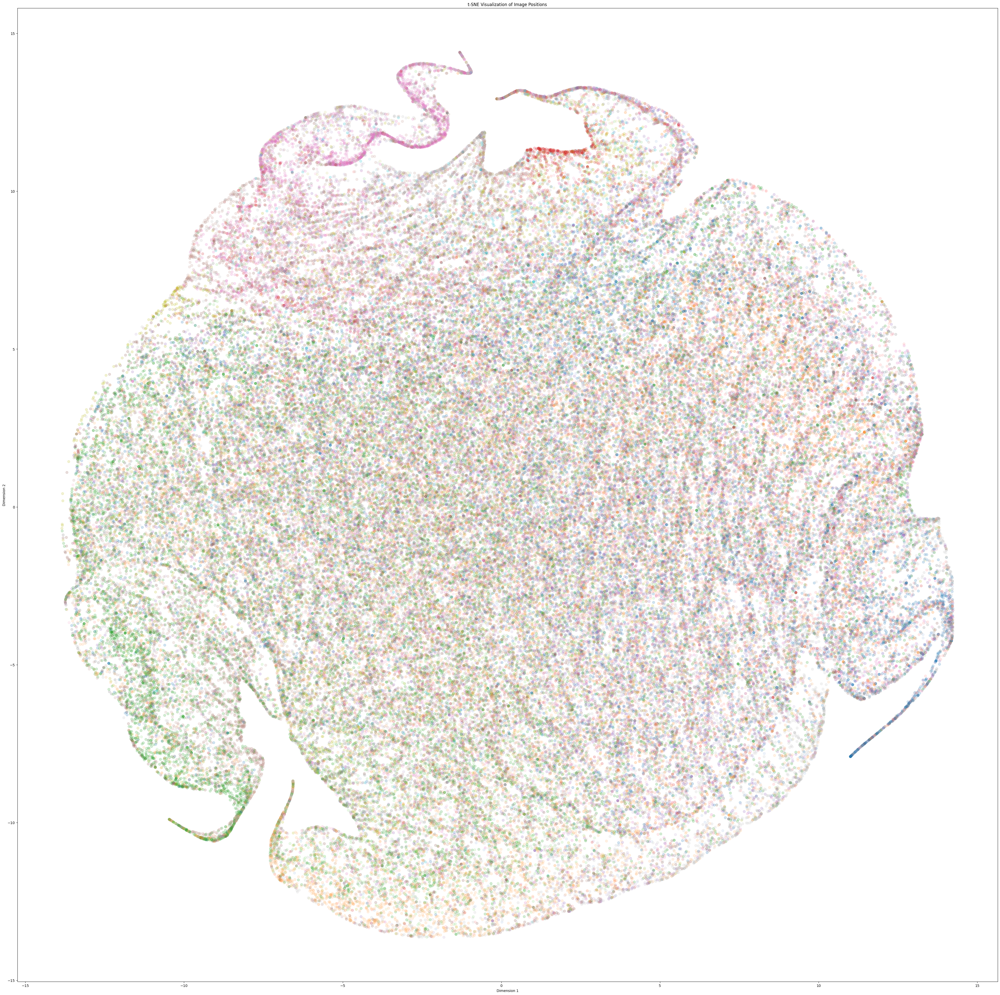

In [121]:
fig, ax = plt.subplots(figsize=(50, 50))
ax.scatter(embedding[:, 0], embedding[:, 1],
            c=max_data.Color.values[:], s=s,
            cmap='tab20', alpha=0.2)
plt.xlabel('Dimension 1')
plt.ylabel('Dimension 2')
plt.title('t-SNE Visualization of Image Positions')
plt.show()

# Umap

alle Daten

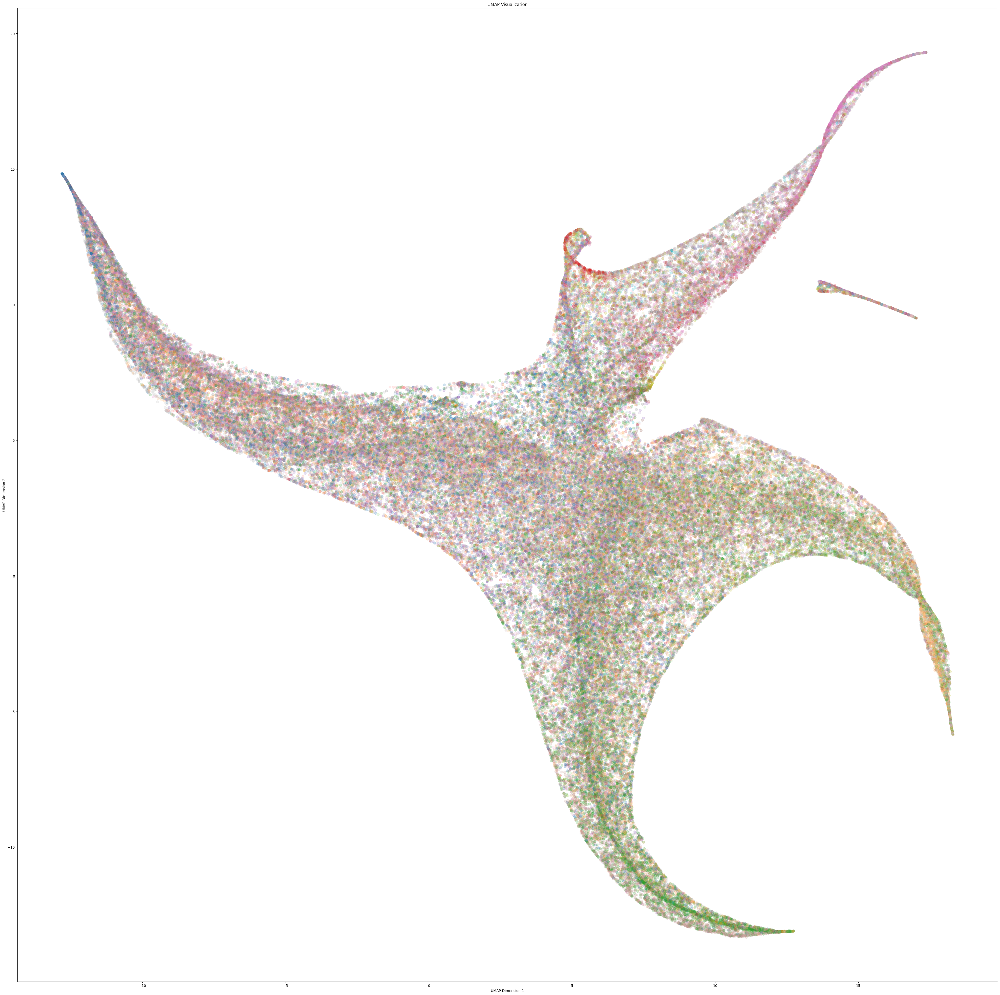

In [122]:
fig, ax = plt.subplots(figsize=(50, 50))
ax.scatter(umap_rest[:, 0], umap_rest[:, 1],
            c=max_data.Color.values[:],s=s[:],
            cmap='tab20', alpha=0.2)
plt.xlabel('UMAP Dimension 1')
plt.ylabel('UMAP Dimension 2')
plt.title('UMAP Visualization')
plt.show()

# Umap als canberra

alle Daten

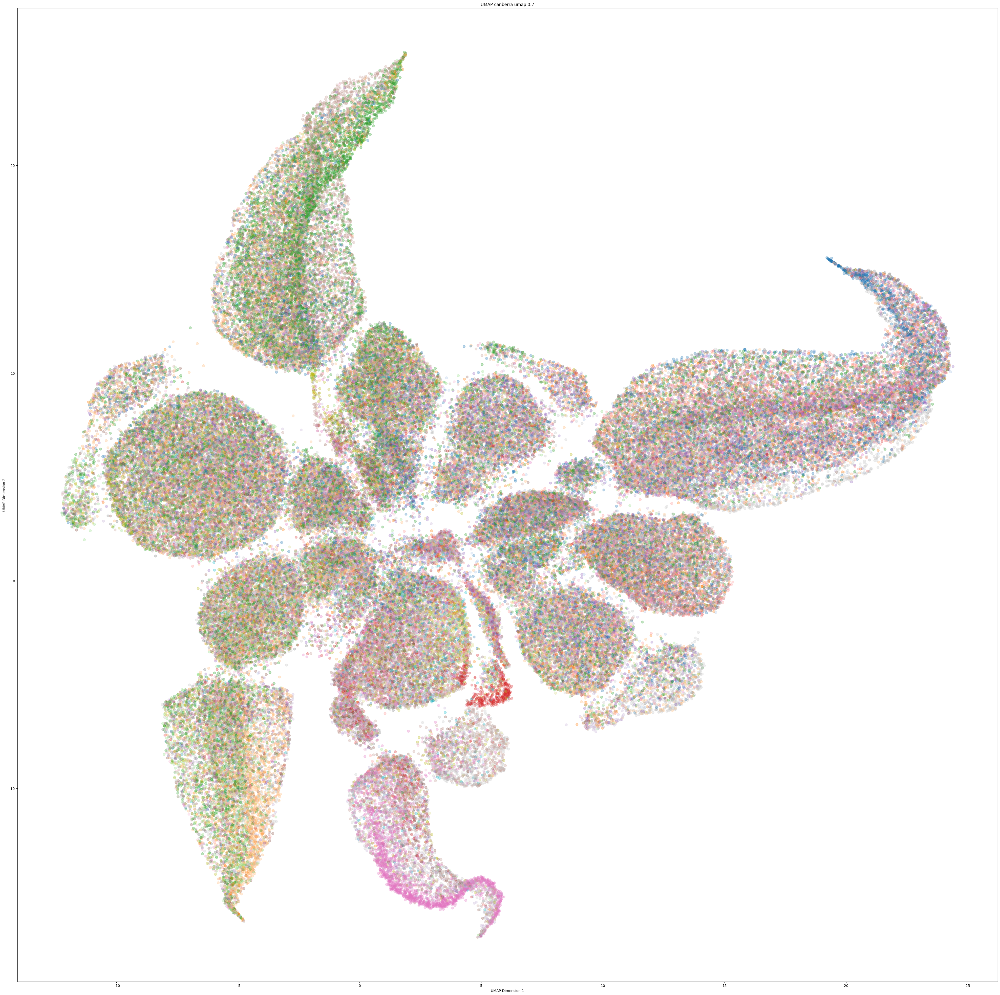

In [133]:
fig, ax = plt.subplots(figsize=(50, 50))
ax.scatter(umap_r[:, 0], umap_r[:, 1],
            c=max_data.Color.values[:], s=s,
            cmap='tab20', alpha=0.3)
plt.xlabel('UMAP Dimension 1')
plt.ylabel('UMAP Dimension 2')
plt.title('UMAP canberra umap 0.7')
plt.show()

# TSNE 

einzelne Werte

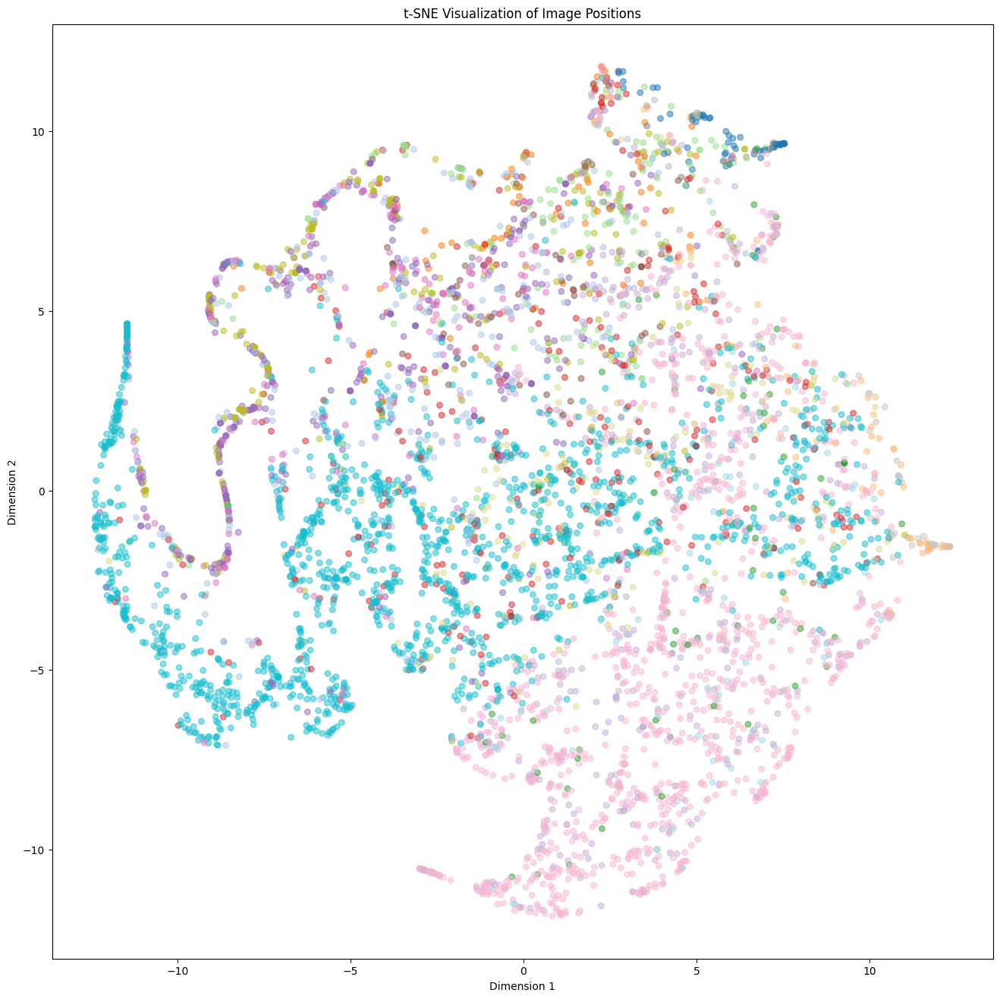

In [124]:
fig, ax = plt.subplots(figsize=(16, 16))
ax.scatter(embedding2[:, 0], embedding2[:, 1],
            c=max2.Color.values[:], s=s2,
            cmap='tab20', alpha=0.5)
plt.xlabel('Dimension 1')
plt.ylabel('Dimension 2')
plt.title('t-SNE Visualization of Image Positions')
plt.show()

# Umap

einzelne Werte

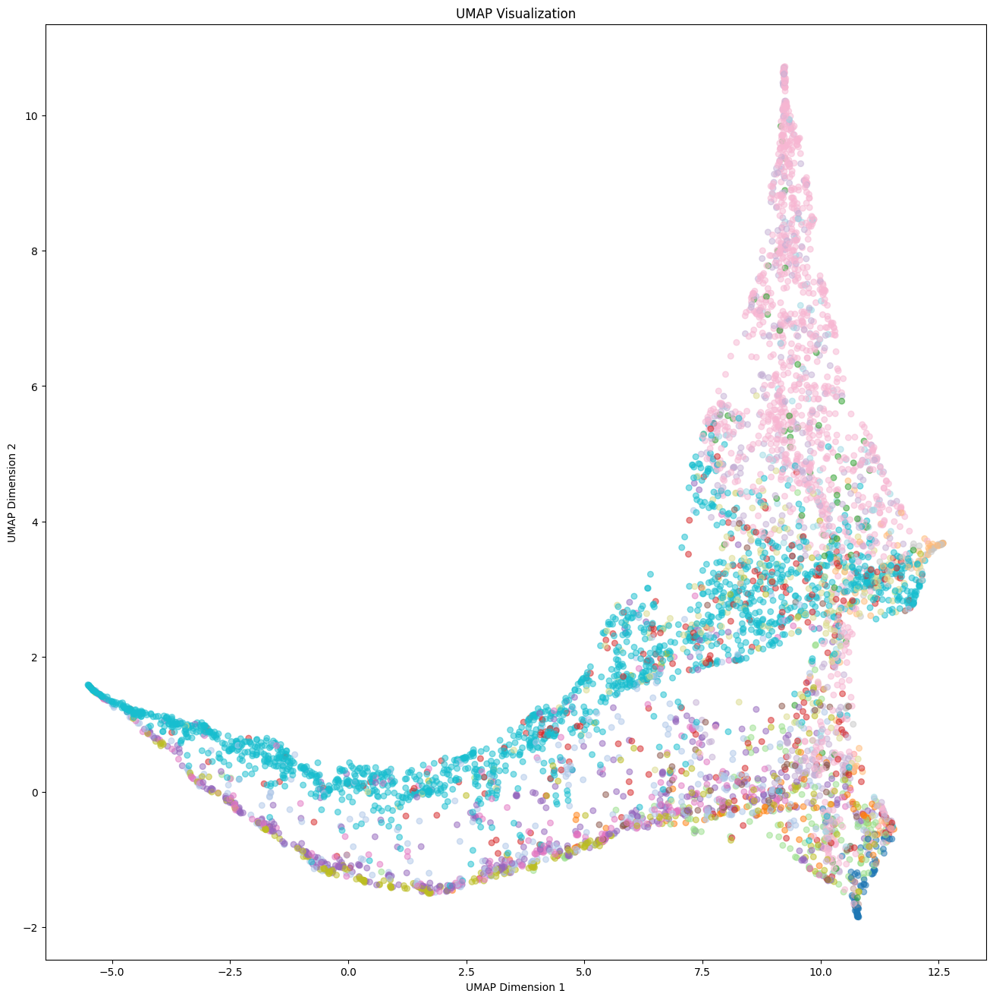

In [125]:
fig, ax = plt.subplots(figsize=(16, 16))
ax.scatter(umap_rest2[:, 0], umap_rest2[:, 1],
            c=max2.Color.values[:],s=s2[:],
            cmap='tab20', alpha=0.5)
plt.xlabel('UMAP Dimension 1')
plt.ylabel('UMAP Dimension 2')
plt.title('UMAP Visualization')
plt.show()